In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import os

from IPython.display import Image


In [12]:
def plot_grid(df_sorted, output_image = "composite.jpg", tile_width = 288, tile_height = 540, columns = 24):

    # 3. Load images in ascending order of lightness
    images = []
    valid_paths = []
    for path in df_sorted["cropped path"]:
        if not os.path.isfile(path):
            print(f"Warning: Image file '{path}' not found. Skipping.")
            continue
        img = cv2.imread(path)
        if img is None:
            print(f"Warning: Could not open '{path}'. Skipping.")
            continue

        # Resize to a uniform thumbnail size
        thumbnail = cv2.resize(img, (tile_width, tile_height))
        images.append(thumbnail)
        valid_paths.append(path) 

    if not images:
        print("No valid images found to build a composite.")
        return

    # Calculate how many rows based on how many images we have and the chosen column count
    total_images = len(images)
    rows = int(np.ceil(total_images / columns))

    # 4. Create a blank canvas for the composite
    composite_height = rows * tile_height
    composite_width = columns * tile_width
    # Using 3 channels (BGR) for color images
    composite = np.zeros((composite_height, composite_width, 3), dtype=np.uint8)

    # Fill the composite grid row by row
    for i, thumb in enumerate(images):
        row = i // columns
        col = i % columns

        y1 = row * tile_height
        y2 = y1 + tile_height
        x1 = col * tile_width
        x2 = x1 + tile_width

        composite[y1:y2, x1:x2] = thumb

    # 5. Save the final composite image
    cv2.imwrite(output_image, composite)
    print(f"Composite grid saved as '{output_image}'")



Composite grid saved as 'composite_lightness_grid.jpg'


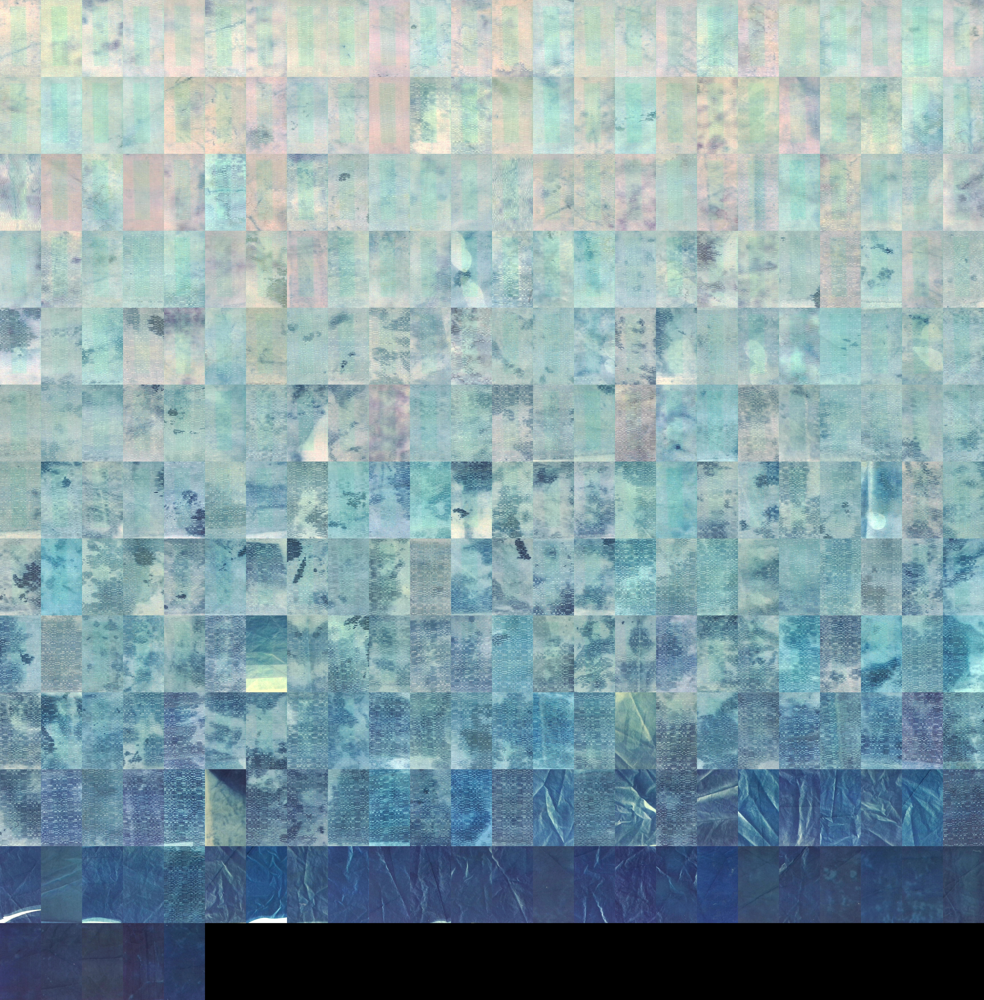

In [18]:
#Import and sort images by lightness

imgs = pd.read_csv("scandata.csv")

imgs_sorted = imgs.sort_values(by="lightness", ascending=False)

plot_grid(imgs_sorted, "composite_lightness_grid.jpg")

Image(filename="composite_lightness_grid.jpg")

Text(0.5, 1.0, 'Lightness of images in the dataset')

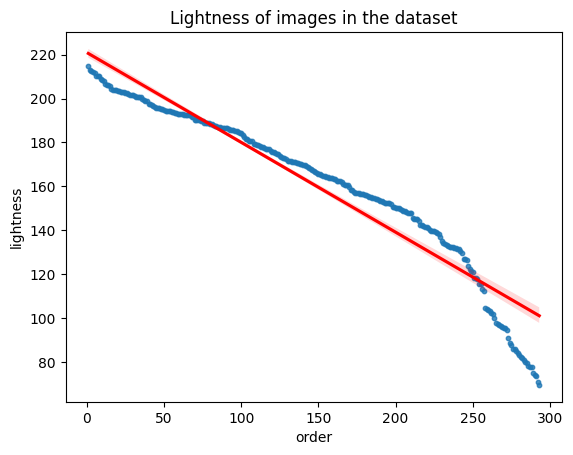

In [49]:
imgs_sorted['order'] = range(1, len(imgs_sorted) + 1)
imgs_sorted

sns.regplot(data=imgs_sorted, x="order", y="lightness", line_kws=dict(color="r"),scatter_kws={"s": 10})
plt.title("Lightness of images in the dataset")


In [43]:
df = pd.read_csv("Average Sea Temperature (F) in La Jolla from 2000-2025 - EXPORT.csv")

df["YEAR"] = df["YEAR"].astype(int)
df["MONTH"] = df["MONTH"].astype(int)
df["avg SURF_TEMP_C"] = df["avg SURF_TEMP_C"].astype(float)
df["order_time"] = range(1, len(df) + 1)

sorted_df = df.sort_values(by="avg SURF_TEMP_C", ascending=True)

#select the desired images here
short_imgs_sorted = imgs_sorted[-len(sorted_df):]

short_imgs_sorted.reset_index(drop=True, inplace=True)
sorted_df.reset_index(drop=True, inplace=True)

combined_df = pd.concat([short_imgs_sorted, sorted_df], axis=1)

combined_df = combined_df.sort_values(by=['MONTH','YEAR'], ascending=True)

combined_df

,index,scan path,cropped path,hue,saturation,lightness,order,YEAR,MONTH,avg SURF_TEMP_C,order_time
27,156,./scanimg/0156.jpg,./cropimg/0156.jpg,67.493454,34.514210,200.696978,33,2000,1,14.76,1
18,134,./scanimg/0134.jpg,./cropimg/0134.jpg,69.427636,30.948682,203.088593,24,2001,1,14.65,13
10,302,./scanimg/0302.jpg,./cropimg/0302.jpg,67.402919,47.412314,204.510680,16,2002,1,14.45,25
55,144,./scanimg/0144.jpg,./cropimg/0144.jpg,79.886735,44.847209,192.829662,61,2003,1,15.52,37
12,32,./scanimg/0032.jpg,./cropimg/0032.jpg,76.752810,90.280961,203.790979,18,2004,1,14.52,49
...,...,...,...,...,...,...,...,...,...,...,...
90,178,./scanimg/0178.jpg,./cropimg/0178.jpg,83.410938,41.272422,185.336388,96,2019,12,16.13,240
61,88,./scanimg/0088.jpg,./cropimg/0088.jpg,86.773630,31.689558,192.381887,67,2020,12,15.66,252
68,297,./scanimg/0297.jpg,./cropimg/0297.jpg,79.396727,44.754604,189.847004,74,2021,12,15.76,264
42,21,./scanimg/0021.jpg,./cropimg/0021.jpg,84.983185,59.052784,195.391377,48,2022,12,15.15,276


Composite grid saved as 'composite_temp_grid.jpg'


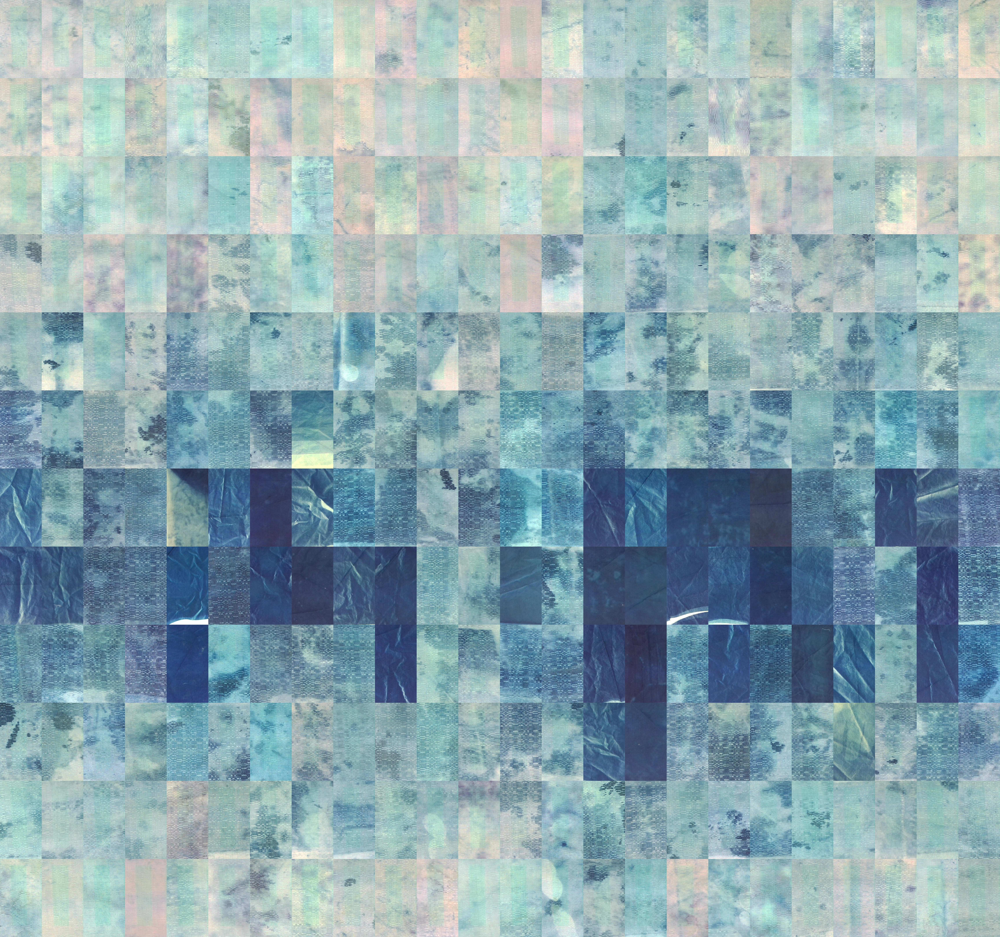

In [44]:
plot_grid(combined_df, "composite_temp_grid.jpg")

Image(filename="composite_temp_grid.jpg")